# Proposal 3

$$
\mathcal{L} = \mathcal{L}_c + \lambda_q \cdot || \bm{p} ||_1 + \lambda_e \cdot || \bm{p^*_A} \odot \bm{(\theta - \theta^*_A) }||_1 + \lambda_f \cdot || \bm{(1 - p)} \odot \bm{\theta} ||_1
$$

In [1]:
%load_ext autoreload
%autoreload 2

# Libraries

In [2]:
import pickle
import pandas as pd
import plotly.express as px
from tqdm import tqdm

In [3]:
from avalanche.benchmarks.classic import PermutedMNIST
from avalanche.models import SimpleMLP
from avalanche.training.plugins import EvaluationPlugin
from avalanche.logging import InteractiveLogger
from avalanche.evaluation.metrics import (
    accuracy_metrics,
    bwt_metrics,
    confusion_matrix_metrics,
    forgetting_metrics,
    timing_metrics,
    cpu_usage_metrics,
    gpu_usage_metrics,
    disk_usage_metrics,
    ram_usage_metrics,
    loss_metrics,
    class_accuracy_metrics,
    accuracy_matrix_metrics
)

from torch.nn import CrossEntropyLoss
from torch.optim import SGD

/Users/jesusoyanedelespinoza/.pyenv/versions/3.9.18/envs/tt2/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Custom Libraries

In [4]:
import sys

sys.path.append("../base_code/")

from base_code.constants import DATASETS_PATH, SAVED_METRICS_PATH
from base_code.training import MWUN
from base_code.plugins import WeightStoragePlugin

# Device

In [5]:
from torch import cuda
device = "cuda" if cuda.is_available() else "cpu"

# Dataset and definitions

## Dataset loading

We load state-of-the-art dataset Modified NIST

In [6]:
scenario = PermutedMNIST(10, seed=1234, dataset_root=DATASETS_PATH)

## Scenario creation with train test streaming

In this point, we define our scenario considering a training where in every experience of it, a new class is presented. This is, first we train with a class $a$, the following experience we train with class $b$ ($a \neq b$)

In [7]:
train_stream = scenario.train_stream
test_stream = scenario.test_stream

## Evaluation metrics definition

In [62]:
eval_plugin = EvaluationPlugin(
    accuracy_metrics(experience=True, stream=True),
    loss_metrics(minibatch=True, experience=True, stream=True),
    timing_metrics(epoch=True, epoch_running=True),
    cpu_usage_metrics(minibatch=True, experience=True, stream=True),
    gpu_usage_metrics(experience=True, stream=True, gpu_id=device),
    disk_usage_metrics(experience=True, stream=True),
    ram_usage_metrics(experience=True, stream=True),
    class_accuracy_metrics(experience=True, stream=True),
    accuracy_matrix_metrics(),
    forgetting_metrics(experience=True, stream=True),
    bwt_metrics(experience=True, stream=True),
    confusion_matrix_metrics(stream=True, num_classes=scenario.n_classes),
    
    loggers=[InteractiveLogger()]
)

/Users/jesusoyanedelespinoza/.pyenv/versions/3.9.18/envs/tt2/lib/python3.9/site-packages/avalanche/evaluation/metrics/gpu_usage.py:56: UserWarning:

Your system has no GPU!

/Users/jesusoyanedelespinoza/.pyenv/versions/3.9.18/envs/tt2/lib/python3.9/site-packages/avalanche/evaluation/metrics/gpu_usage.py:56: UserWarning:

Your system has no GPU!



## Plugin defitinitions

In [63]:
model_plugins = [WeightStoragePlugin()]

## Model, Optimizer, Loss function and Strategy definition

* `model`: Multi Layer Perceptron
* `Optimizer`: Adam
* `Loss function`: Cross Entropy
* `Strategy`: Elastic Weight Consolidation

In [64]:
model = SimpleMLP(num_classes=scenario.n_classes, input_size=28 * 28, hidden_layers=2, hidden_size=100).to(device)
optimizer = SGD(model.parameters(), lr=1e-3)
criterion = CrossEntropyLoss().to(device)
strategy = MWUN(
    model,
    optimizer,
    criterion,
    eps=1e-2,
    train_epochs=5,
    train_mb_size=128,
    lambda_q=1/(90_000),
    plugins=model_plugins,
    evaluator=eval_plugin,
    eval_mb_size=128,
    device=device
)

# Training and evaluation

Revisar porque el entrenamiento se está comportando de forma rara

  0%|          | 0/10 [00:00<?, ?it/s]

-- >> Start of training phase << --
100%|██████████| 469/469 [00:04<00:00, 102.51it/s]
Epoch 0 ended.
	CPUUsage_MB/train_phase/train_stream/Task000 = 129.9000
	Loss_MB/train_phase/train_stream/Task000 = 17.6585
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0001
	Time_Epoch/train_phase/train_stream/Task000 = 4.5754
100%|██████████| 469/469 [00:04<00:00, 106.57it/s]
Epoch 1 ended.
	CPUUsage_MB/train_phase/train_stream/Task000 = 137.1000
	Loss_MB/train_phase/train_stream/Task000 = 17.2915
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0000
	Time_Epoch/train_phase/train_stream/Task000 = 4.4010
100%|██████████| 469/469 [00:04<00:00, 106.34it/s]
Epoch 2 ended.
	CPUUsage_MB/train_phase/train_stream/Task000 = 138.5000
	Loss_MB/train_phase/train_stream/Task000 = 16.8586
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0000
	Time_Epoch/train_phase/train_stream/Task000 = 4.4103
100%|██████████| 469/469 [00:04<00:00, 105.19it/s]
Epoch 3 ended.
	CPUUsage_MB/train_phase/tra

 10%|█         | 1/10 [00:31<04:43, 31.52s/it]

-- >> End of eval phase << --
	CPUUsage_Stream/eval_phase/test_stream/Task000 = 106.4046
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x291f631f0>
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 53400.7031
	EvalStream/Acc_Matrix = 
tensor([[0.7011, 0.1719, 0.2120, 0.1742, 0.1258, 0.1327, 0.1410, 0.1322, 0.1827,
         0.1753],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
   

 20%|██        | 2/10 [01:03<04:13, 31.72s/it]

-- >> End of eval phase << --
	CPUUsage_Stream/eval_phase/test_stream/Task000 = 105.7966
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x1694c87f0>
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 53400.7031
	EvalStream/Acc_Matrix = 
tensor([[0.7011, 0.1719, 0.2120, 0.1742, 0.1258, 0.1327, 0.1410, 0.1322, 0.1827,
         0.1753],
        [0.6667, 0.7442, 0.2368, 0.1819, 0.2190, 0.1382, 0.2216, 0.1098, 0.1789,
         0.2092],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
   

 30%|███       | 3/10 [01:34<03:41, 31.58s/it]

-- >> End of eval phase << --
	CPUUsage_Stream/eval_phase/test_stream/Task000 = 106.3986
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x280b19130>
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 53400.7031
	EvalStream/Acc_Matrix = 
tensor([[0.7011, 0.1719, 0.2120, 0.1742, 0.1258, 0.1327, 0.1410, 0.1322, 0.1827,
         0.1753],
        [0.6667, 0.7442, 0.2368, 0.1819, 0.2190, 0.1382, 0.2216, 0.1098, 0.1789,
         0.2092],
        [0.6472, 0.7460, 0.7823, 0.1618, 0.1968, 0.1767, 0.2062, 0.1196, 0.1816,
         0.1887],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
   

 40%|████      | 4/10 [02:06<03:08, 31.44s/it]

-- >> End of eval phase << --
	CPUUsage_Stream/eval_phase/test_stream/Task000 = 106.4276
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x2f6d110d0>
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 53400.7031
	EvalStream/Acc_Matrix = 
tensor([[0.7011, 0.1719, 0.2120, 0.1742, 0.1258, 0.1327, 0.1410, 0.1322, 0.1827,
         0.1753],
        [0.6667, 0.7442, 0.2368, 0.1819, 0.2190, 0.1382, 0.2216, 0.1098, 0.1789,
         0.2092],
        [0.6472, 0.7460, 0.7823, 0.1618, 0.1968, 0.1767, 0.2062, 0.1196, 0.1816,
         0.1887],
        [0.6507, 0.7302, 0.7729, 0.7918, 0.1713, 0.1378, 0.2283, 0.1994, 0.1693,
         0.1495],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
   

 50%|█████     | 5/10 [02:36<02:35, 31.01s/it]

-- >> End of eval phase << --
	CPUUsage_Stream/eval_phase/test_stream/Task000 = 106.2822
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x2fbccfac0>
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 53400.7031
	EvalStream/Acc_Matrix = 
tensor([[0.7011, 0.1719, 0.2120, 0.1742, 0.1258, 0.1327, 0.1410, 0.1322, 0.1827,
         0.1753],
        [0.6667, 0.7442, 0.2368, 0.1819, 0.2190, 0.1382, 0.2216, 0.1098, 0.1789,
         0.2092],
        [0.6472, 0.7460, 0.7823, 0.1618, 0.1968, 0.1767, 0.2062, 0.1196, 0.1816,
         0.1887],
        [0.6507, 0.7302, 0.7729, 0.7918, 0.1713, 0.1378, 0.2283, 0.1994, 0.1693,
         0.1495],
        [0.6681, 0.7414, 0.7861, 0.7664, 0.8024, 0.1303, 0.1573, 0.1672, 0.1780,
         0.1581],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
   

 60%|██████    | 6/10 [03:06<02:02, 30.67s/it]

-- >> End of eval phase << --
	CPUUsage_Stream/eval_phase/test_stream/Task000 = 106.1720
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x2fc6cb550>
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 53400.7031
	EvalStream/Acc_Matrix = 
tensor([[0.7011, 0.1719, 0.2120, 0.1742, 0.1258, 0.1327, 0.1410, 0.1322, 0.1827,
         0.1753],
        [0.6667, 0.7442, 0.2368, 0.1819, 0.2190, 0.1382, 0.2216, 0.1098, 0.1789,
         0.2092],
        [0.6472, 0.7460, 0.7823, 0.1618, 0.1968, 0.1767, 0.2062, 0.1196, 0.1816,
         0.1887],
        [0.6507, 0.7302, 0.7729, 0.7918, 0.1713, 0.1378, 0.2283, 0.1994, 0.1693,
         0.1495],
        [0.6681, 0.7414, 0.7861, 0.7664, 0.8024, 0.1303, 0.1573, 0.1672, 0.1780,
         0.1581],
        [0.6567, 0.7313, 0.7780, 0.7750, 0.7935, 0.7998, 0.1424, 0.2025, 0.1700,
         0.1367],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
   

 70%|███████   | 7/10 [03:36<01:31, 30.45s/it]

-- >> End of eval phase << --
	CPUUsage_Stream/eval_phase/test_stream/Task000 = 106.1650
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x2e2114bb0>
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 53400.7031
	EvalStream/Acc_Matrix = 
tensor([[0.7011, 0.1719, 0.2120, 0.1742, 0.1258, 0.1327, 0.1410, 0.1322, 0.1827,
         0.1753],
        [0.6667, 0.7442, 0.2368, 0.1819, 0.2190, 0.1382, 0.2216, 0.1098, 0.1789,
         0.2092],
        [0.6472, 0.7460, 0.7823, 0.1618, 0.1968, 0.1767, 0.2062, 0.1196, 0.1816,
         0.1887],
        [0.6507, 0.7302, 0.7729, 0.7918, 0.1713, 0.1378, 0.2283, 0.1994, 0.1693,
         0.1495],
        [0.6681, 0.7414, 0.7861, 0.7664, 0.8024, 0.1303, 0.1573, 0.1672, 0.1780,
         0.1581],
        [0.6567, 0.7313, 0.7780, 0.7750, 0.7935, 0.7998, 0.1424, 0.2025, 0.1700,
         0.1367],
        [0.6704, 0.7220, 0.7579, 0.7588, 0.7910, 0.7889, 0.8013, 0.1486, 0.1532,
         0.1284],
   

 80%|████████  | 8/10 [04:07<01:01, 30.68s/it]

-- >> End of eval phase << --
	CPUUsage_Stream/eval_phase/test_stream/Task000 = 106.1756
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x1624c4b20>
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 53400.7031
	EvalStream/Acc_Matrix = 
tensor([[0.7011, 0.1719, 0.2120, 0.1742, 0.1258, 0.1327, 0.1410, 0.1322, 0.1827,
         0.1753],
        [0.6667, 0.7442, 0.2368, 0.1819, 0.2190, 0.1382, 0.2216, 0.1098, 0.1789,
         0.2092],
        [0.6472, 0.7460, 0.7823, 0.1618, 0.1968, 0.1767, 0.2062, 0.1196, 0.1816,
         0.1887],
        [0.6507, 0.7302, 0.7729, 0.7918, 0.1713, 0.1378, 0.2283, 0.1994, 0.1693,
         0.1495],
        [0.6681, 0.7414, 0.7861, 0.7664, 0.8024, 0.1303, 0.1573, 0.1672, 0.1780,
         0.1581],
        [0.6567, 0.7313, 0.7780, 0.7750, 0.7935, 0.7998, 0.1424, 0.2025, 0.1700,
         0.1367],
        [0.6704, 0.7220, 0.7579, 0.7588, 0.7910, 0.7889, 0.8013, 0.1486, 0.1532,
         0.1284],
   

 90%|█████████ | 9/10 [04:39<00:30, 30.99s/it]

-- >> End of eval phase << --
	CPUUsage_Stream/eval_phase/test_stream/Task000 = 105.9768
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x2f868fd90>
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 53400.7031
	EvalStream/Acc_Matrix = 
tensor([[0.7011, 0.1719, 0.2120, 0.1742, 0.1258, 0.1327, 0.1410, 0.1322, 0.1827,
         0.1753],
        [0.6667, 0.7442, 0.2368, 0.1819, 0.2190, 0.1382, 0.2216, 0.1098, 0.1789,
         0.2092],
        [0.6472, 0.7460, 0.7823, 0.1618, 0.1968, 0.1767, 0.2062, 0.1196, 0.1816,
         0.1887],
        [0.6507, 0.7302, 0.7729, 0.7918, 0.1713, 0.1378, 0.2283, 0.1994, 0.1693,
         0.1495],
        [0.6681, 0.7414, 0.7861, 0.7664, 0.8024, 0.1303, 0.1573, 0.1672, 0.1780,
         0.1581],
        [0.6567, 0.7313, 0.7780, 0.7750, 0.7935, 0.7998, 0.1424, 0.2025, 0.1700,
         0.1367],
        [0.6704, 0.7220, 0.7579, 0.7588, 0.7910, 0.7889, 0.8013, 0.1486, 0.1532,
         0.1284],
   

100%|██████████| 10/10 [05:33<00:00, 33.32s/it]

-- >> End of eval phase << --
	CPUUsage_Stream/eval_phase/test_stream/Task000 = 105.8241
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x282faa3d0>
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 53400.7031
	EvalStream/Acc_Matrix = 
tensor([[0.7011, 0.1719, 0.2120, 0.1742, 0.1258, 0.1327, 0.1410, 0.1322, 0.1827,
         0.1753],
        [0.6667, 0.7442, 0.2368, 0.1819, 0.2190, 0.1382, 0.2216, 0.1098, 0.1789,
         0.2092],
        [0.6472, 0.7460, 0.7823, 0.1618, 0.1968, 0.1767, 0.2062, 0.1196, 0.1816,
         0.1887],
        [0.6507, 0.7302, 0.7729, 0.7918, 0.1713, 0.1378, 0.2283, 0.1994, 0.1693,
         0.1495],
        [0.6681, 0.7414, 0.7861, 0.7664, 0.8024, 0.1303, 0.1573, 0.1672, 0.1780,
         0.1581],
        [0.6567, 0.7313, 0.7780, 0.7750, 0.7935, 0.7998, 0.1424, 0.2025, 0.1700,
         0.1367],
        [0.6704, 0.7220, 0.7579, 0.7588, 0.7910, 0.7889, 0.8013, 0.1486, 0.1532,
         0.1284],
   

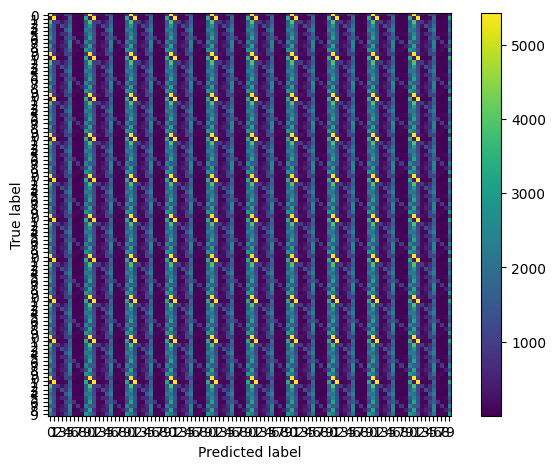

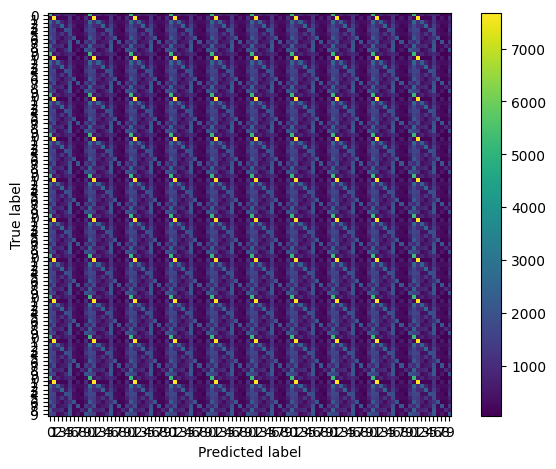

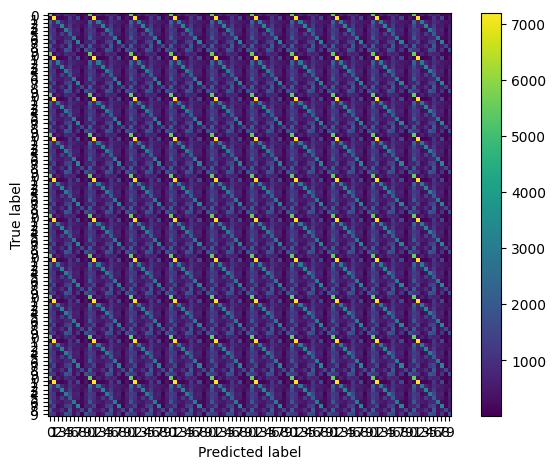

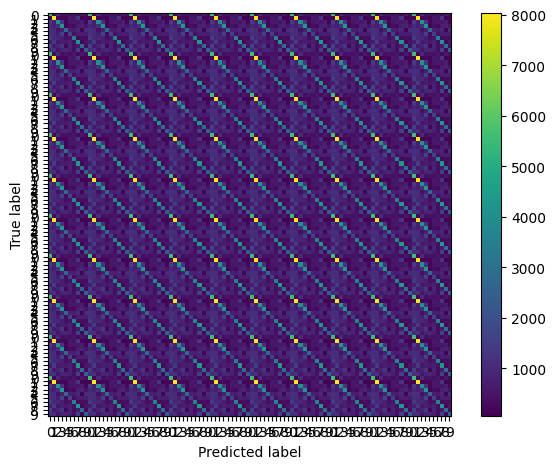

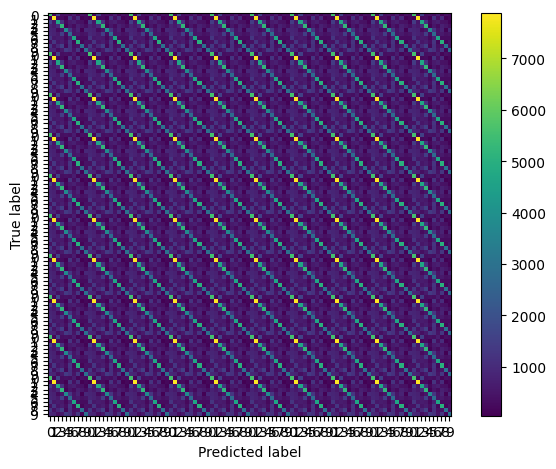

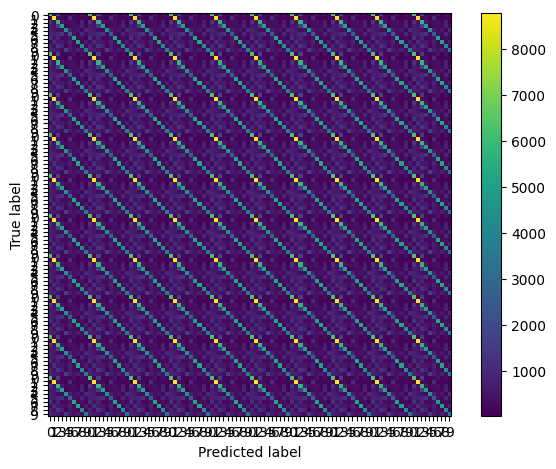

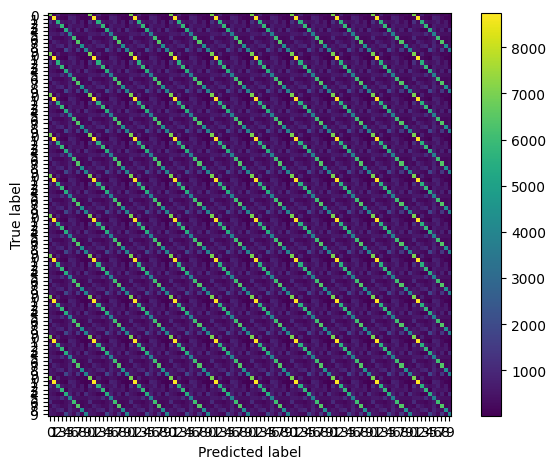

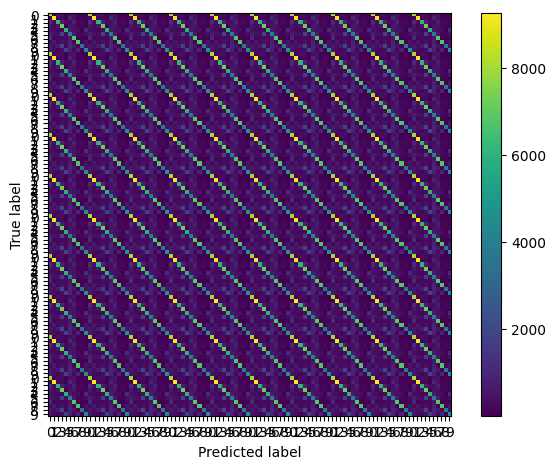

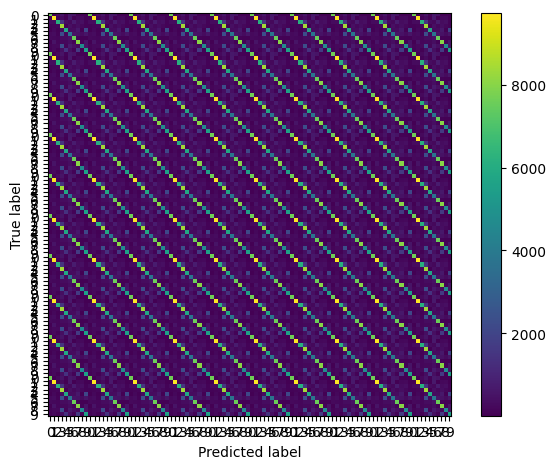

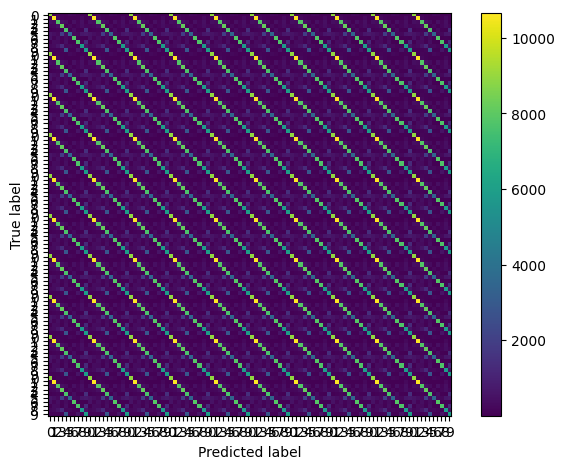

In [65]:
results = list()

for experience in tqdm(train_stream):
    strategy.train(experience)
    metrics = strategy.eval(test_stream)
    results.append(metrics)

# Get metrics

In [66]:
accuracies: dict[int, list[float]] = dict()
forgettings: dict[int, list[float]] = dict()
bwt: dict[int, list[float]] = dict()
class_accuracies: dict[int, list[float]] = dict()
losses: dict[int, list[float]] = dict()

for i in range(10):
    accuracies[f"Task{i}"] = eval_plugin.get_all_metrics()[
        f"Top1_Acc_Exp/eval_phase/test_stream/Task000/Exp00{i}"
    ][1]
    forgettings[f"Task{i}"] = eval_plugin.get_all_metrics()[
        f"ExperienceForgetting/eval_phase/test_stream/Task000/Exp00{i}"
    ][1]
    bwt[f"Task{i}"] = eval_plugin.get_all_metrics()[
        f"ExperienceBWT/eval_phase/test_stream/Task000/Exp00{i}"
    ][1]
    class_accuracies[f"Task{i}"] = eval_plugin.get_all_metrics()[
        f"Top1_ClassAcc_Stream/eval_phase/test_stream/Task000/{i}"
    ][1]
    losses[f"Task{i}"] = eval_plugin.get_all_metrics()[
        f"Loss_Exp/eval_phase/test_stream/Task000/Exp00{i}"
    ][1]
        

accuracies["Overall"] = eval_plugin.get_all_metrics()[
    "Top1_Acc_Stream/eval_phase/test_stream/Task000"
][1]

In [67]:
train_cpu_usage = eval_plugin.get_all_metrics()["CPUUsage_MB/train_phase/train_stream/Task000"][1]
train_time_epoch = eval_plugin.get_all_metrics()["Time_Epoch/train_phase/train_stream/Task000"][1]
train_running_time = eval_plugin.get_all_metrics()["RunningTime_Epoch/train_phase/train_stream/Task000"][1]
train_loss_epoch = eval_plugin.get_all_metrics()["Loss_MB/train_phase/train_stream/Task000"][1]

In [68]:
all_loss_components = strategy.get_store_loss()

In [69]:
weights = model_plugins[0].weights

# Store metrics

In [70]:
pickle.dump({
    "accuracies": accuracies,
    "forgettings": forgettings,
    "bwt": bwt,
    "class_accuracies": class_accuracies,
    "losses": losses,
    "train_cpu_usage": train_cpu_usage,
    "train_time_epoch": train_time_epoch,
    "train_running_time": train_running_time,
    "train_loss_epoch": train_loss_epoch,
    "all_loss_components": all_loss_components,
    "weights": weights
}, open(SAVED_METRICS_PATH / "mwun.pkl", "wb"))

# Load

In [71]:
metrics = pickle.load(open(SAVED_METRICS_PATH / "mwun.pkl", "rb"))

# Plot metrics

## Accuracy

In [72]:
fig = px.line(
    pd.DataFrame(metrics["accuracies"]),
    title="Accuracy vs Task",
    labels=dict(index="Task", value="Accuracy"),
    width=800,
    height=600,
    range_y=[0, 1],
    markers=True,
)
fig.update_xaxes(type="category")
fig.show()

## Forgetting

In [73]:
forgetting_processed = dict()
for i, (key, value) in enumerate(metrics["forgettings"].items()):
    forgetting_processed[key] = [float("nan")] * i + value

fig = px.line(
    pd.DataFrame(forgetting_processed),
    title="Forgetting vs Task",
    labels=dict(index="Task", value="Forgetting"),
    width=800,
    height=600,
    markers=True,
)
fig.update_xaxes(type="category")
fig.show()

## Losses

In [74]:
fig = px.line(
    pd.DataFrame(metrics["losses"]),
    title="Losses vs Task",
    labels=dict(index="Task", value="Loss"),
    width=800,
    height=600,
    markers=True,
)
fig.update_xaxes(type="category")
fig.show()

## CPU Usage

In [75]:
fig = px.line(
    metrics["train_cpu_usage"],
    title="CPU Usage vs Batch",
    labels=dict(index="Batch", value="Value"),
    width=800,
    height=600,
)
fig.update_xaxes(type="category")
fig.show()

## Time per epoch

In [76]:
fig = px.line(
    metrics["train_time_epoch"],
    title="Time per Epoch vs Epoch",
    labels=dict(index="Epoch", value="Value"),
    width=800,
    height=600,
)
fig.update_xaxes(type="category")
fig.show()

## Running time

In [77]:
fig = px.line(
    metrics["train_running_time"],
    title="Running Time vs Batch",
    labels=dict(index="Batch", value="Value"),
    width=800,
    height=600,
)
fig.update_xaxes(type="category")
fig.show()

## Training loss

In [78]:
fig = px.line(
    metrics["train_loss_epoch"],
    title="Loss vs Batch",
    labels=dict(index="Batch", value="Value"),
    width=800,
    height=600,
)
fig.update_xaxes(type="category")
fig.show()

## All components losses

In [79]:
fig = px.line(
    metrics["all_loss_components"],
    title="Loss Components vs Batch",
    labels=dict(index="Batch", value="Value"),
    width=800,
    height=600,
    log_y=True,
)
fig.update_xaxes(type="category")
fig.show()

## Weights used

In [80]:
used_weights = list(map(lambda x: sum((abs(x) > 1e-5)).item(), metrics["weights"]))

In [81]:
fig = px.line(
    used_weights,
    title="Used Weights vs Task",
    labels=dict(index="Task", value="Value"),
    width=800,
    height=600,
)
fig.update_xaxes(type="category")
fig.show()

# Weight distribution

In [82]:
weight_distributions = list(map(lambda x: sorted(x.flatten()), metrics["weights"]))

In [84]:
for i in range(10):
    fig = px.histogram(
        weight_distributions[i],
        title=f"Weight Distribution for Task {i}",
        labels=dict(index="Weight", value="Value"),
        width=800,
        height=600,
    )
    fig.show()